## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Packages

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed

%matplotlib inline

## Compute the camera calibration using chessboard images

The images are in the `./camera_cal` folder. Use the CV2 `findChessboardCorners` function to find the corners and add them to the image points list. We can then use this list and the list of object points in the CV2 `calibrateCamera` function to get the camera distortion coefficients.

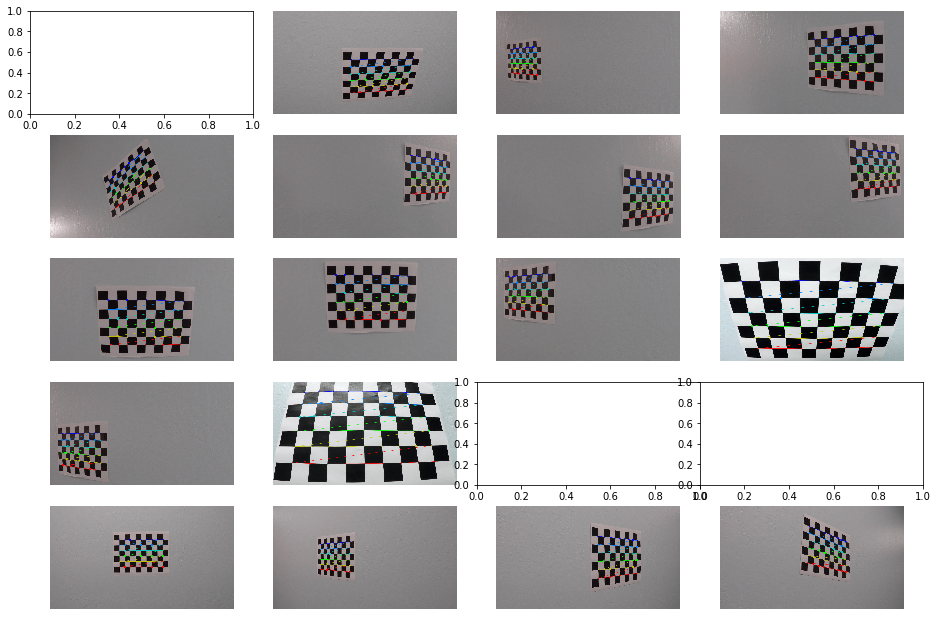

In [2]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners

for i, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        axs[i].axis('off')
        axs[i].imshow(img)

*** Note that some of the images do not show because the chessboard corners were not found (ret == False).

### Calculate the disortion coefficients

In [3]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

### Helper function to apply the distortion correction to an image

In [4]:
def undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

### Example of applying distortion correction to an image

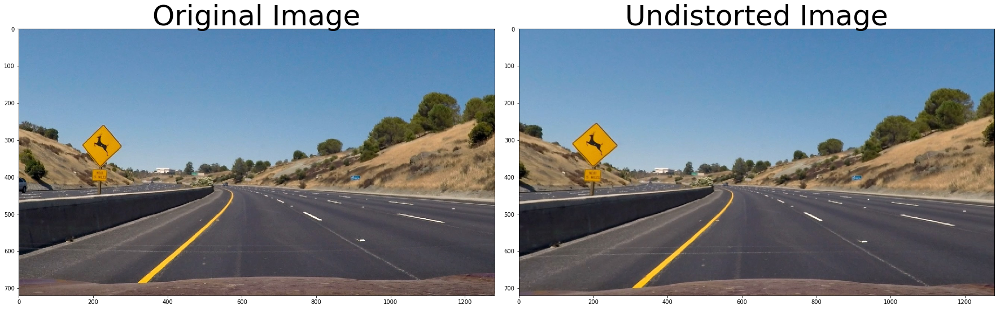

In [5]:
fname = './test_images/test2.jpg'

img = mpimg.imread(fname)

# Use the undistort function, with the mtx and dist calculated above
undist = undistort(img, mtx, dist)

### print an example plot of a comparison of a distorted and undistorted image
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

The undistorted image looks different around the sign and on the hood of the car.

# Perspective Transform

#### Helper function to add lines to an image
this will help us view the prospective transforms

In [7]:
def add_points(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = 2
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.line(img2, (x0, y0), (x1, y1), color, thickness)
    cv2.line(img2, (x1, y1), (x2, y2), color, thickness)
    cv2.line(img2, (x2, y2), (x3, y3), color, thickness)
    cv2.line(img2, (x3, y3), (x0, y0), color, thickness)
    return img2

#### Function to warp images based on source and destination points

In [19]:
def warper(img):

    # Points for the original image
    src = np.float32([
        [250, 675],
        [590, 450], 
        [690, 450], 
        [1055, 675]
    ])

    # Points for the new image
    dst = np.float32([
        [250, 750],
        [250, 0], 
        [1035, 0], 
        [1035, 750]
    ])
    
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped

#### Generate warped perspectives for the straight lines to calibrate the points

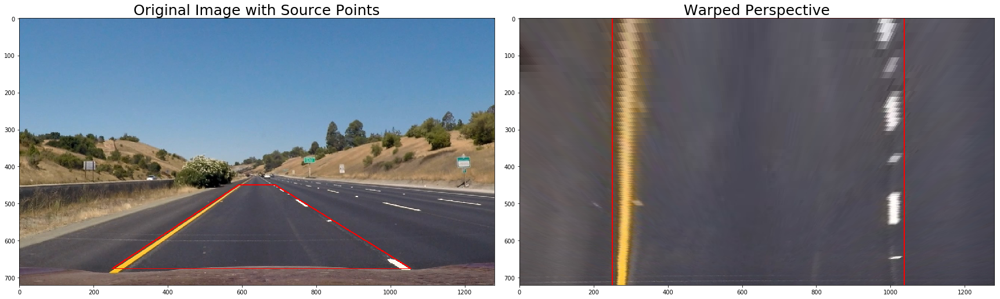

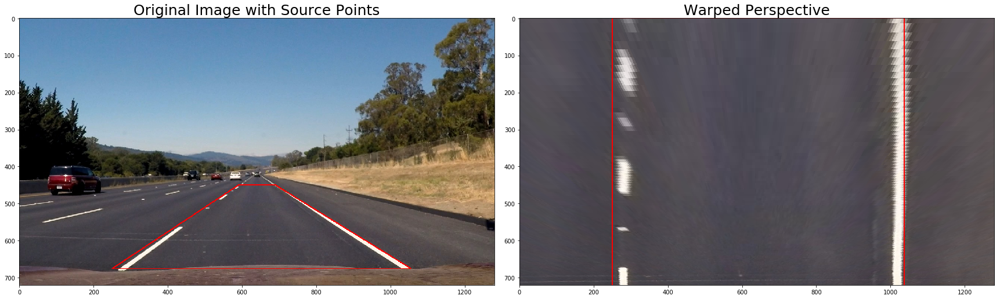

In [20]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/straight*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    dst_points_warped = add_points(warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#### Run these settings over all the images and take a look

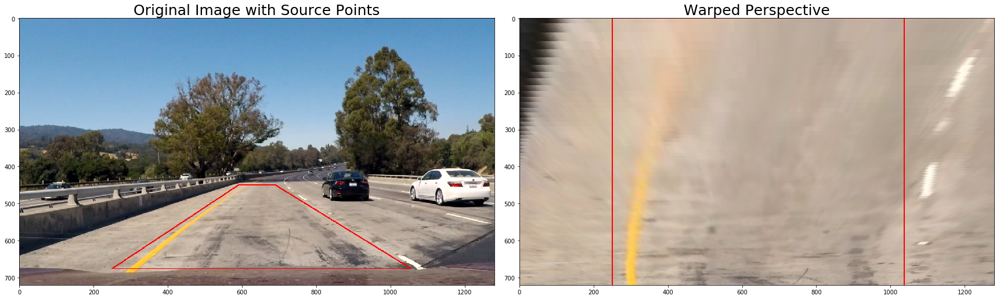

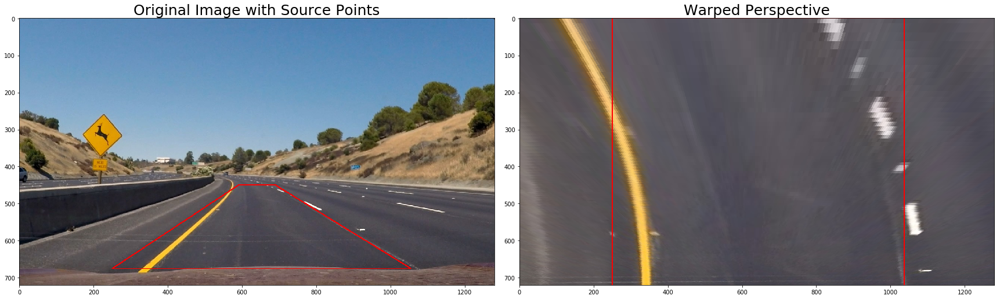

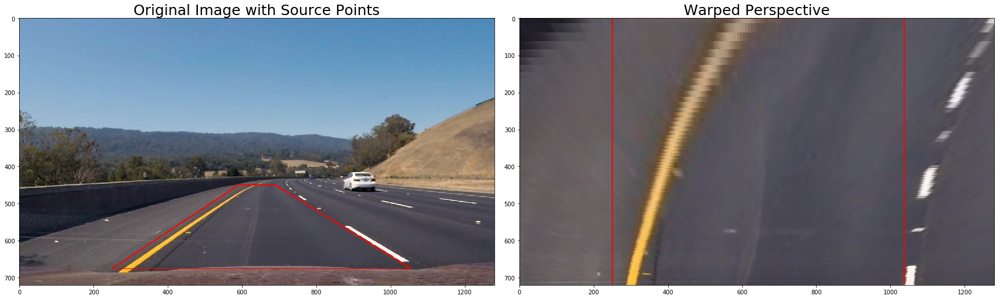

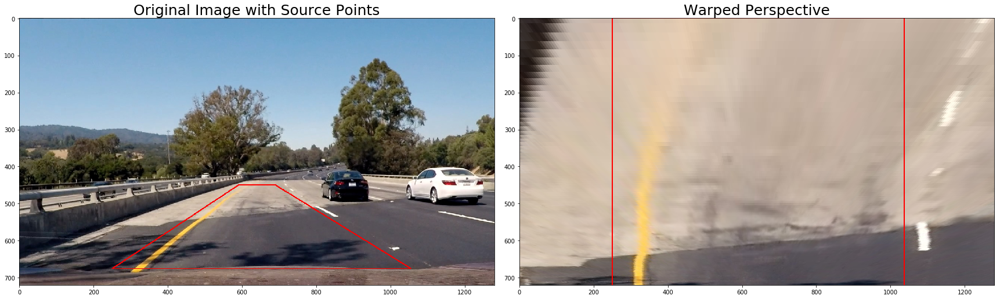

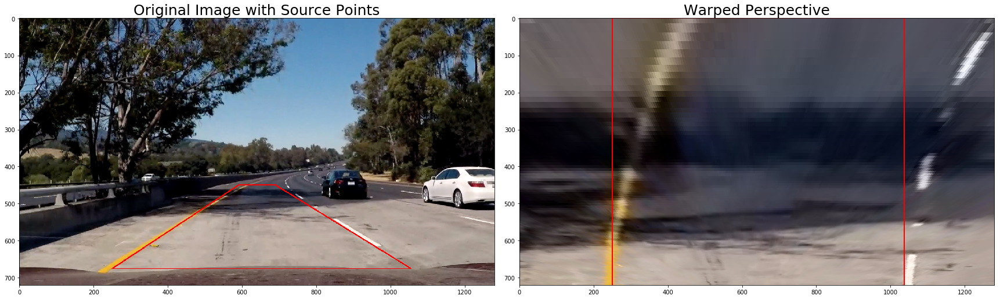

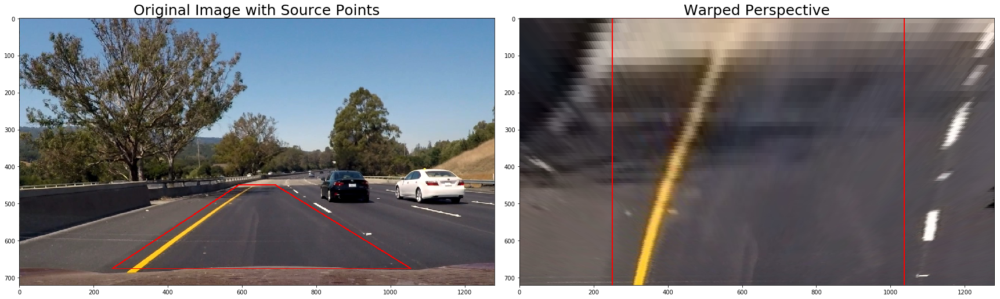

In [21]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    dst_points_warped = add_points(warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

That looks pretty good! We're capturing most of the line information with the transform

# Investigation for binary threshold images

Loop through all the test images and take a look at the different channels for each type of color (RGB, HLS, HSV) to try and see which ones might work best for the binary thresholding

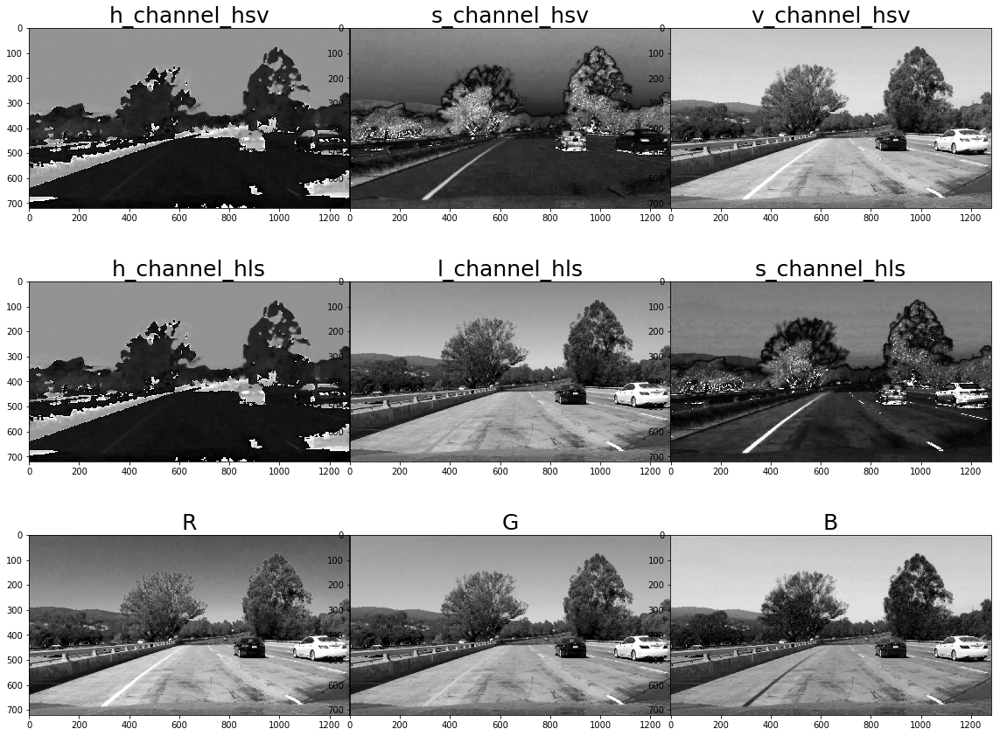

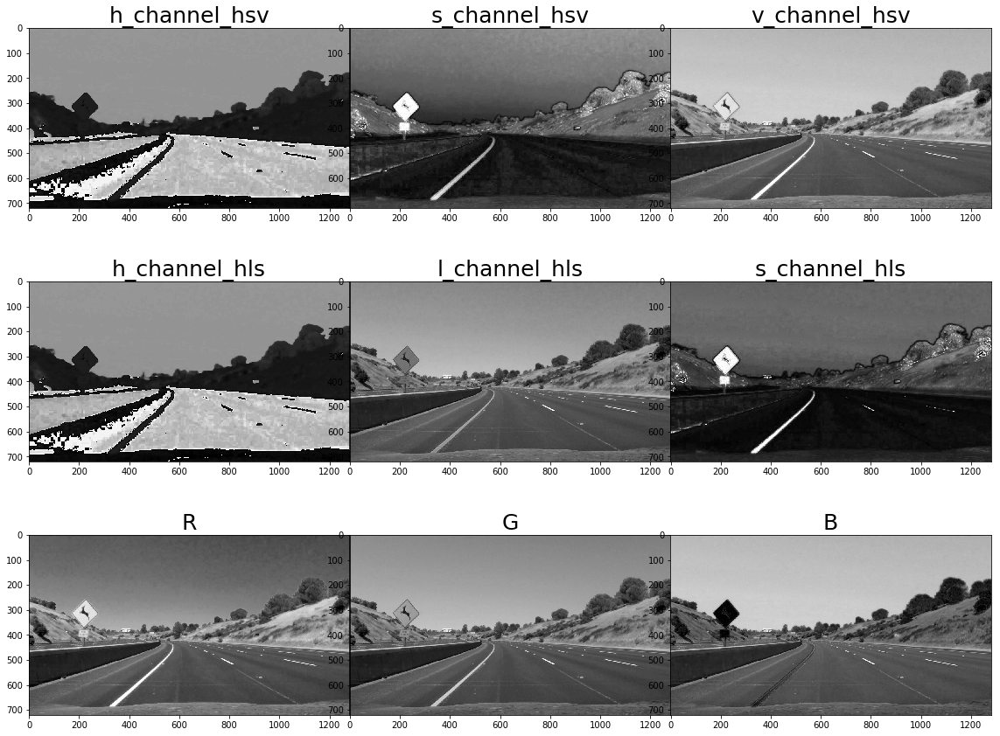

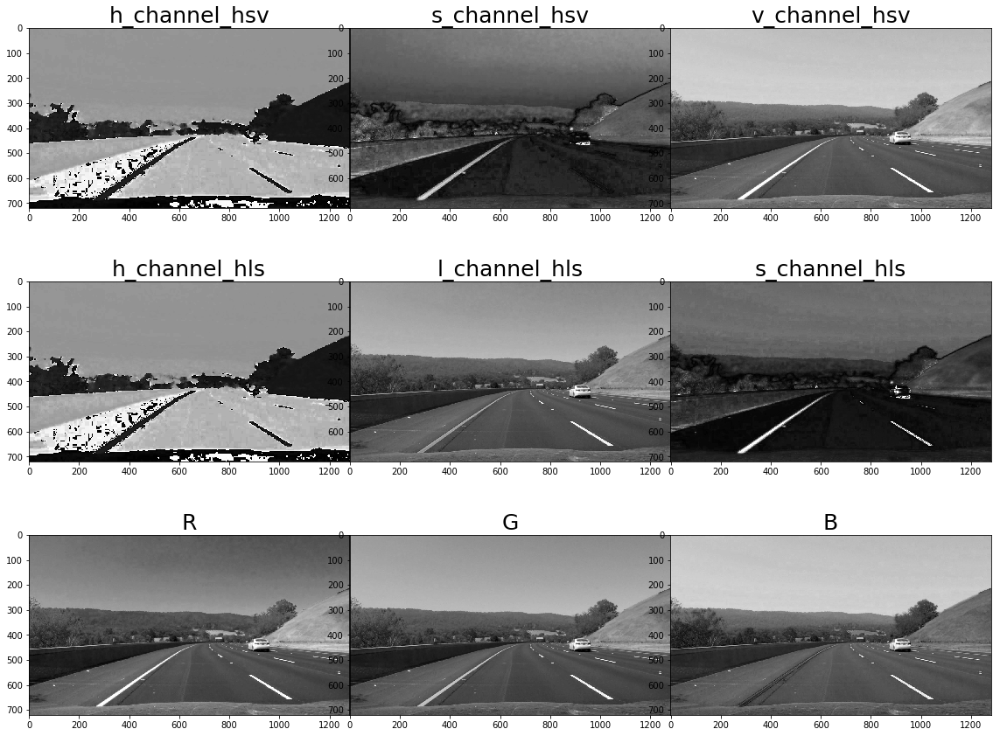

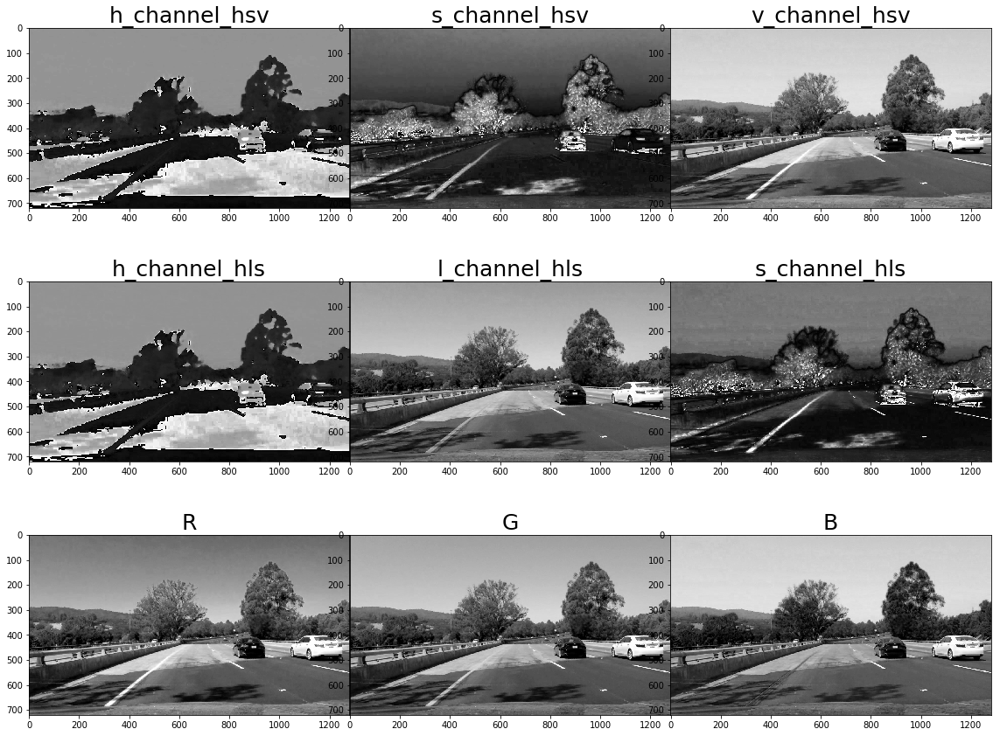

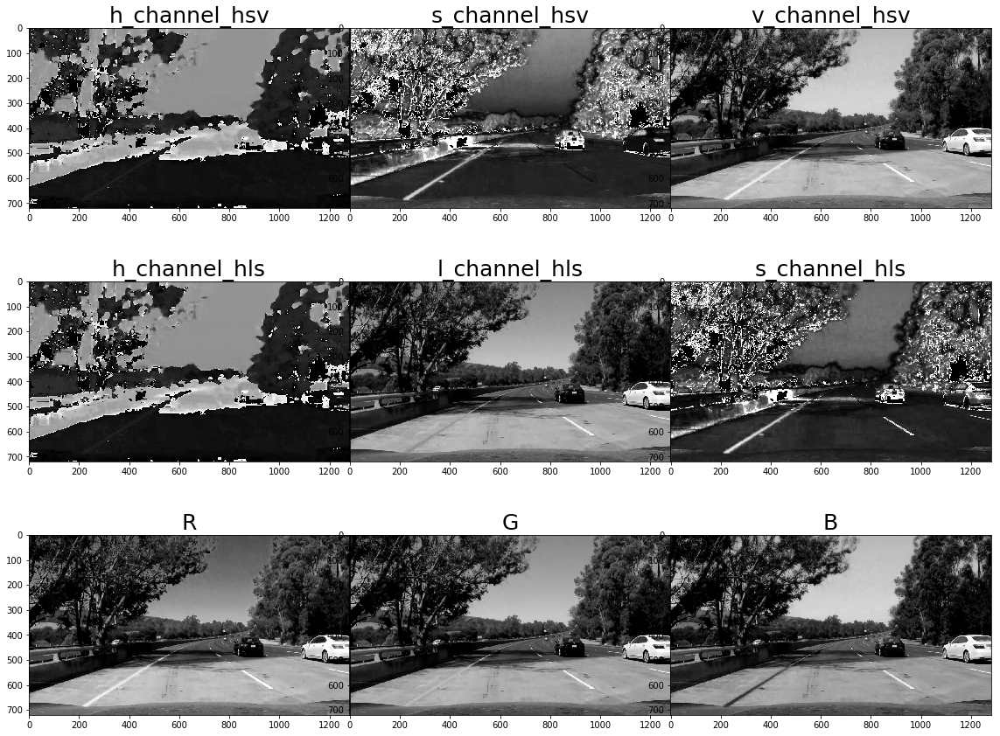

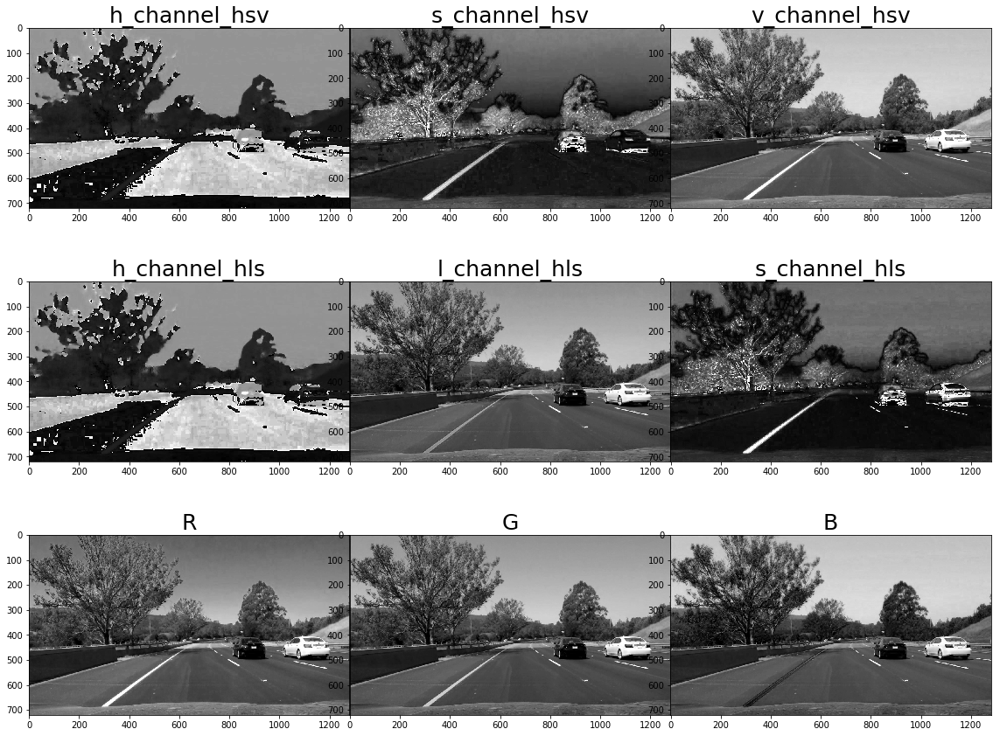

In [12]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.float)

    # Separate the RGB
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize=(16, 12))
    f.tight_layout()

    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.set_title('h_channel_hsv', fontsize=25)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=25)
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=25)
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.set_title('h_channel_hls', fontsize=25)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=25)
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=25)

    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=25)
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=25)
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=25)

    plt.subplots_adjust(hspace = .2, wspace=.001)


From these images, it looks like the saturation channels could provide good data, also the V from HSV and the L from HLS. The Red channel from RGB could be promising as well.

### Do the same thing, but look at images with perspective transform

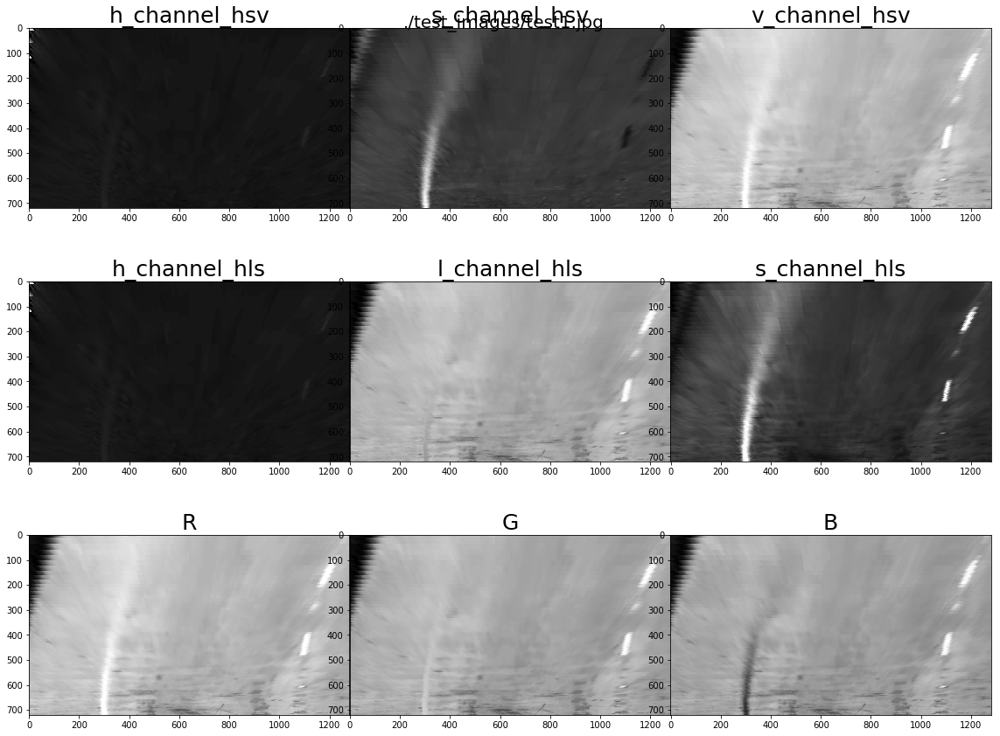

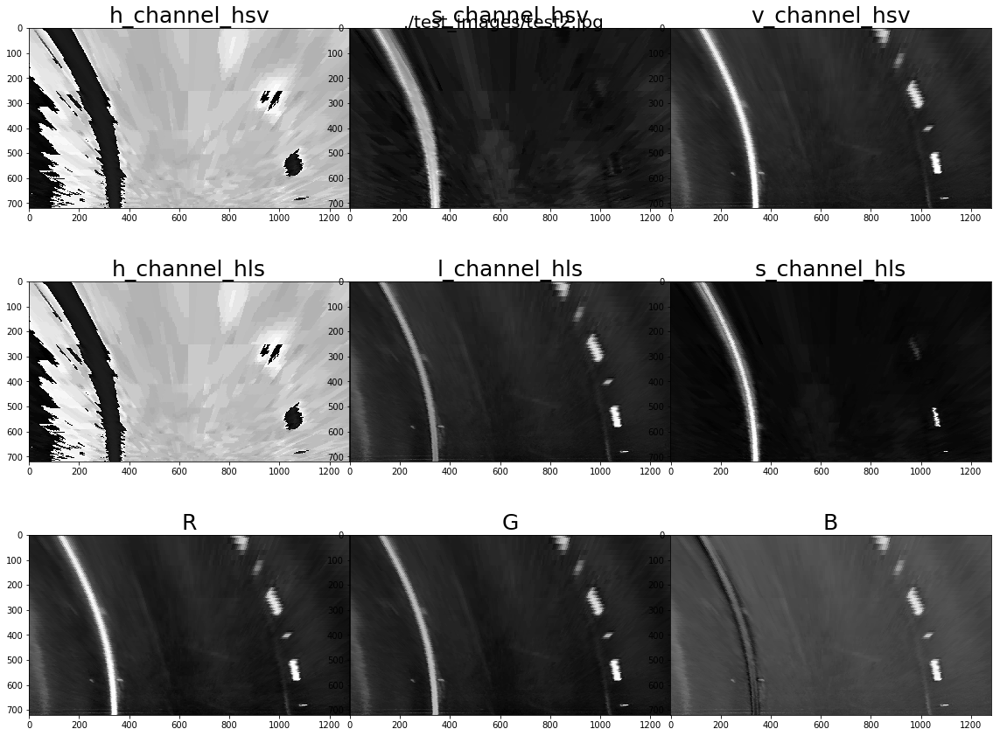

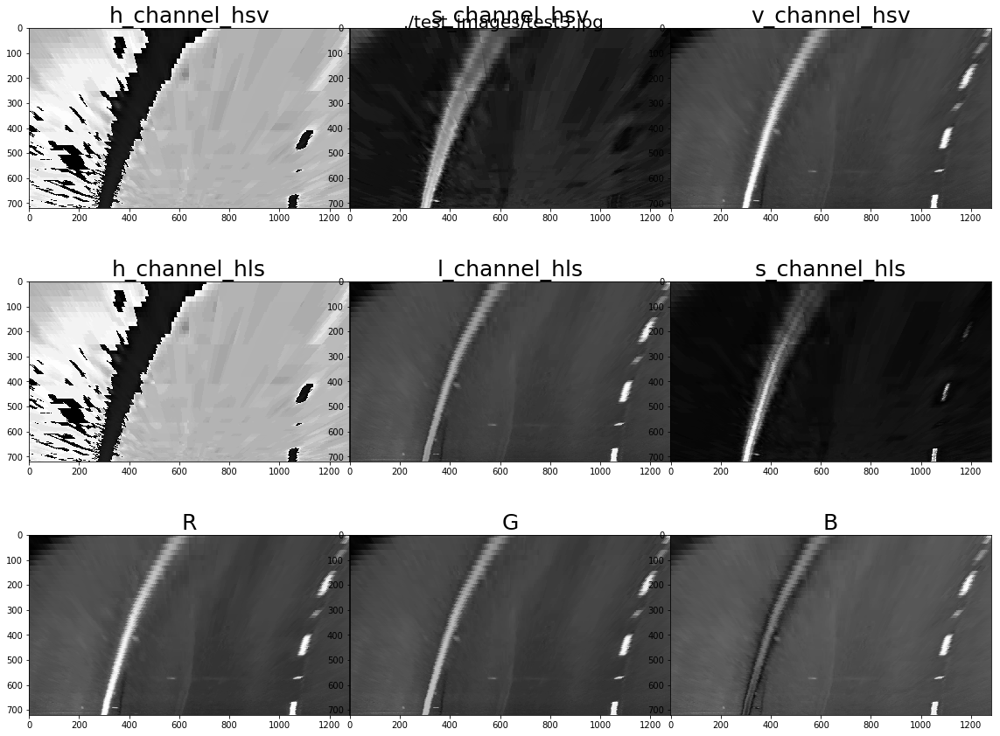

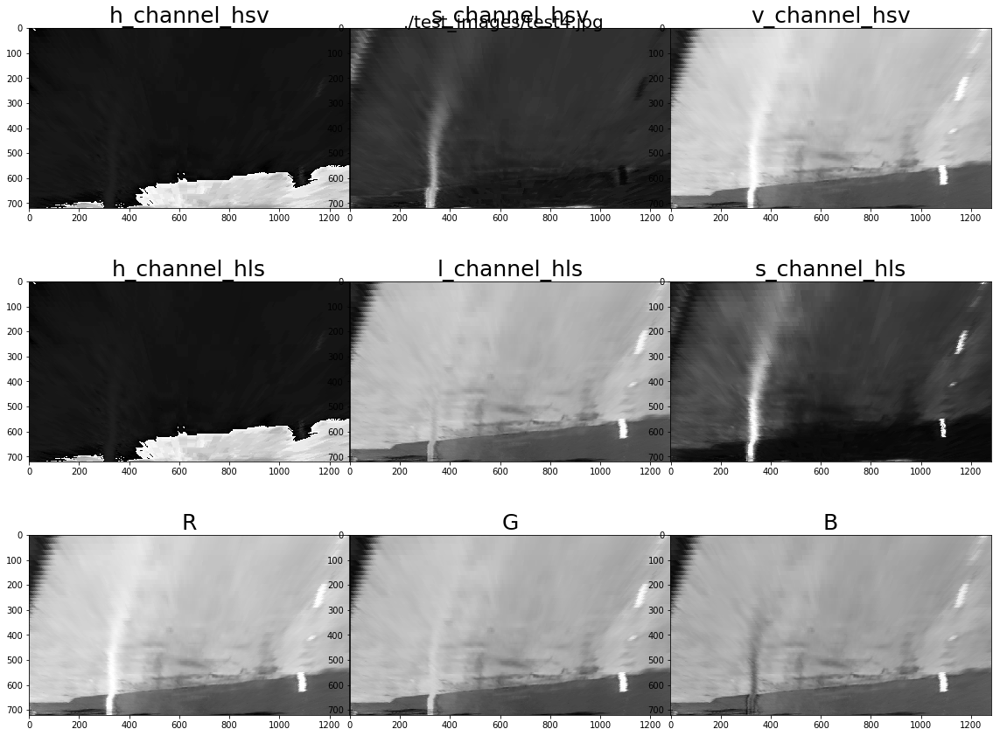

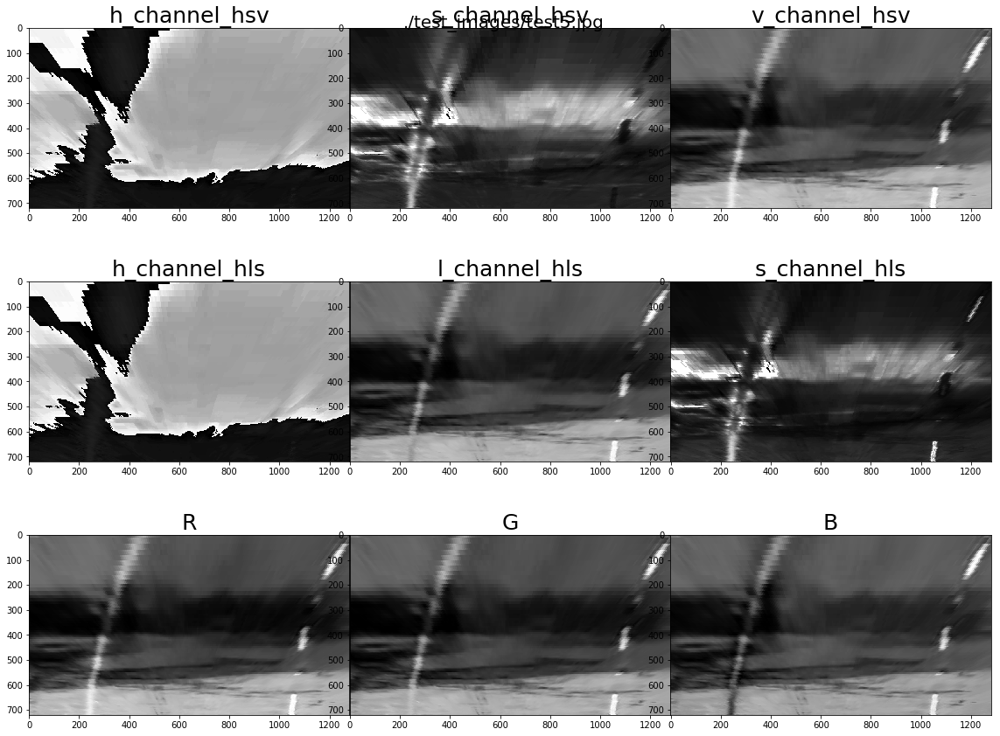

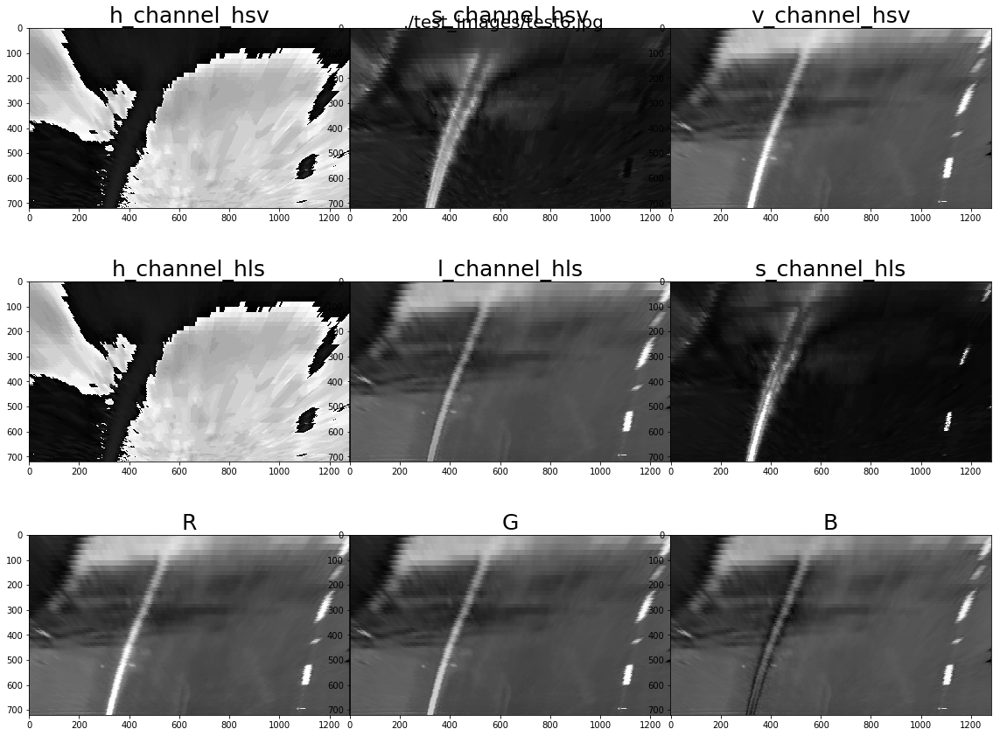

In [41]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    # warp the image
    warped = warper(undist)

    # Separate the RGB
    R = warped[:,:,0]
    G = warped[:,:,1]
    B = warped[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize=(16, 12))
    f.tight_layout()
    f.suptitle(fname, fontsize=20)
    
    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.set_title('h_channel_hsv', fontsize=25)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=25)
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=25)
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.set_title('h_channel_hls', fontsize=25)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=25)
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=25)

    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=25)
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=25)
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=25)

    plt.subplots_adjust(hspace = .2, wspace=.001)

### Look at binary outputs from these different channels on one of the images, and fiddle with the thresholds

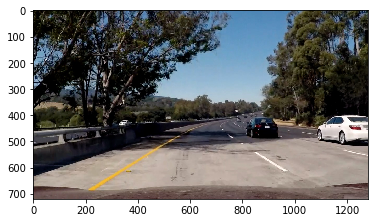

In [170]:
fname = glob.glob('./test_images/test5.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

fname

plt.imshow(img)

#### Helper function to apply the given thresholds to a gvien image color channel

In [164]:
def applyThreshold(channel, thresh):
    # 2) Apply a threshold to the S channel
    binary_output = np.zeros_like(channel)
    
    # Inclusive thresholds 
    binary_output[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    
    # 3) Return a binary image of threshold result
    return binary_output

#### HLS Saturation Channel 

In [165]:

def hls_sthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the S channelc
    s_channel = hls[:,:,2]
    # Return the applied threshold binary image
    return applyThreshold(s_channel, thresh)
    

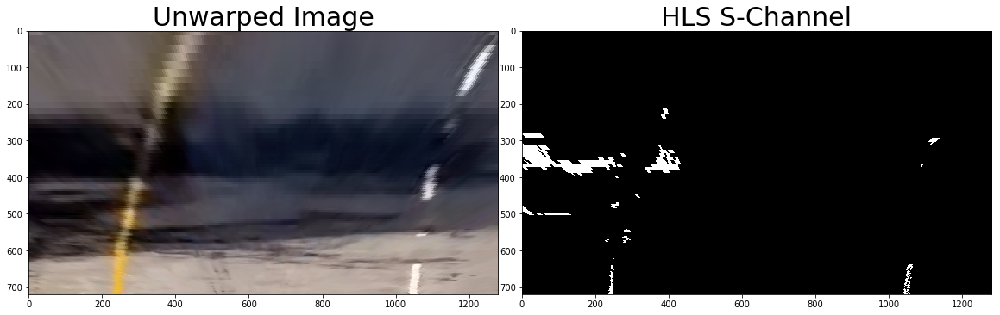

In [166]:
def hls_sthresh_update(min_thresh, max_thresh):
    
    img_sthresh = hls_sthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_sthresh, cmap='gray')
    ax2.set_title('HLS S-Channel', fontsize=30)

interact(hls_sthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### HLS L Channel

In [171]:
def hls_lthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the L channelc
    channel = hls[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)
    

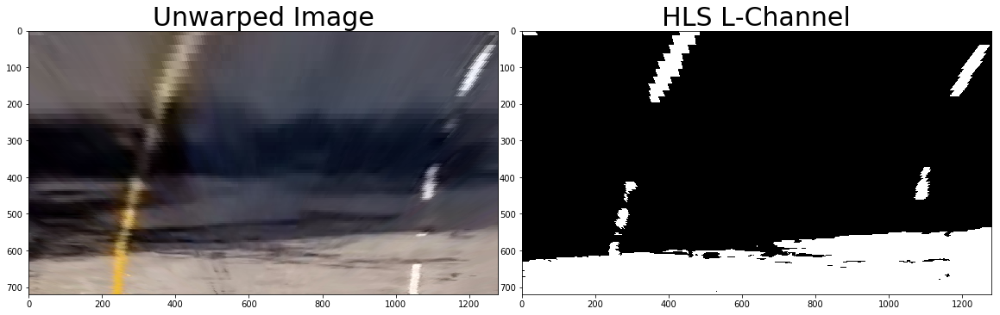

In [172]:
def hls_lthresh_update(min_thresh, max_thresh):
    
    img_lthresh = hls_lthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_lthresh, cmap='gray')
    ax2.set_title('HLS L-Channel', fontsize=30)

interact(hls_lthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### HSV V channel

In [44]:
def hsv_vthresh(img, thresh=(125, 255)):
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # Pull out the V channelc
    channel = hsv[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

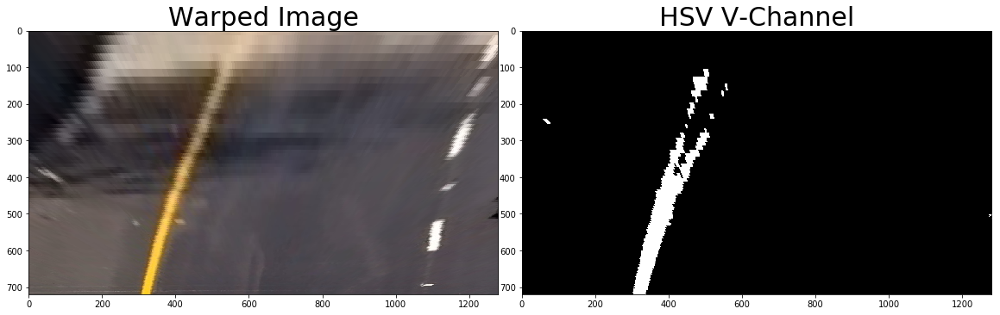

In [45]:
def hsv_vthresh_update(min_thresh, max_thresh):
    
    thresh_img = hsv_vthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('HSV V-Channel', fontsize=30)

interact(hsv_vthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

### RGB Red Channel

In [49]:
def rgb_rthresh(img, thresh=(125, 255)):
    # Pull out the R channelc
    channel = img[:,:,0]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

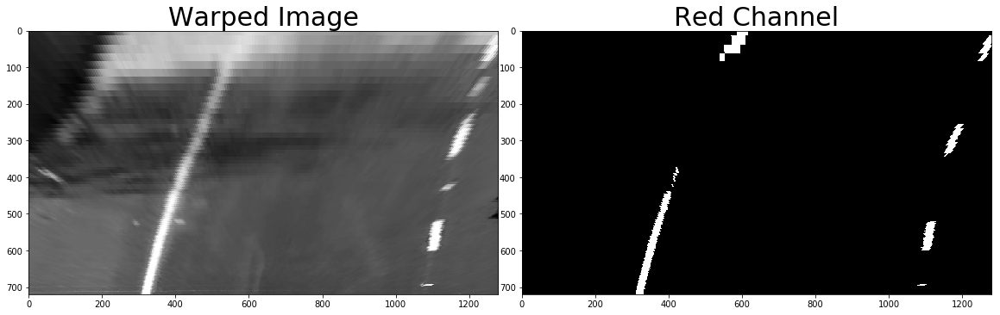

In [53]:
def rgb_rthresh_update(min_thresh, max_thresh):
    
    thresh_img = rgb_rthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped[:,:,0], cmap='gray')
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('Red Channel', fontsize=30)

interact(rgb_rthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### Loop thorugh each image with some of the settings we've found here, and see how we do

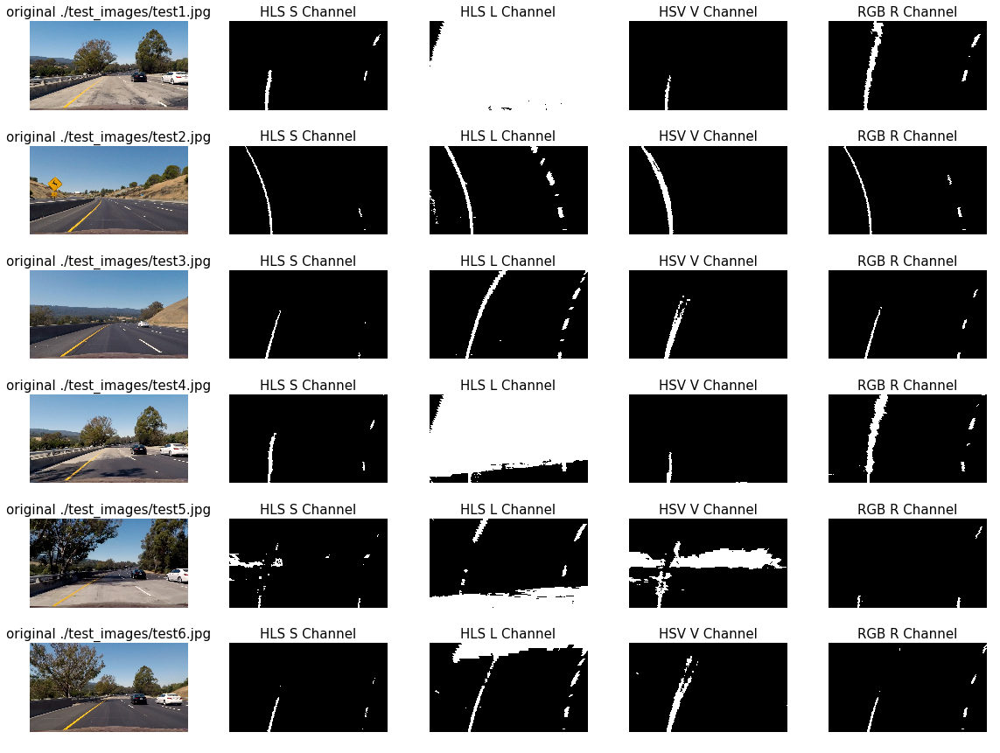

In [167]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(125, 255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    axs[i].axis('off')
    axs[i].imshow(undist)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(L, cmap='gray')
    axs[i].set_title('HLS L Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1

Looking at this, the S and the R channel probably do the best on these example images.

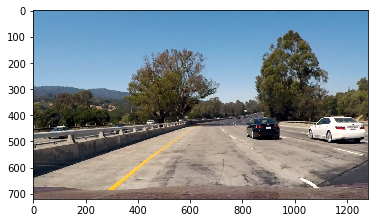

In [131]:
fname = glob.glob('./test_images/test1.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

plt.imshow(img)

In [174]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def calc_sobel(img, sobel_kernel=25, mag_thresh=(25, 255)):
    
    # Convert to grayscale - sobel can only have one color channel
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    L = hls[:,:,1]
    
    # Take the sobel gradient in x and y
    sobelx = cv2.Sobel(L, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(L, cv2.CV_64F, 0, 1)
    
    # Calculate the magnitude 
#     mag_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
#     scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    scaled_sobel = np.uint8(255*sobelx/np.max(sobelx))
    
    # Create a binary mask where mag thresholds are met
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return sxbinary


<function __main__.update>

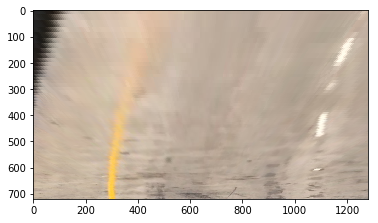

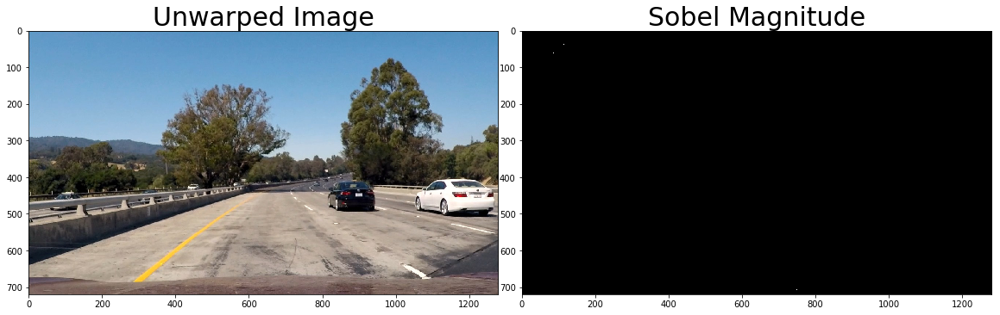

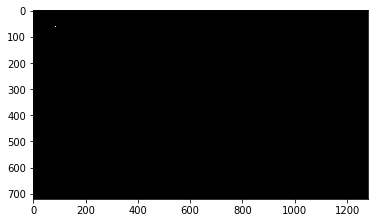

In [175]:



def update(kernel_size, min_thresh, max_thresh):
    plt.imshow(warped)
    sobel = calc_sobel(warped, kernel_size, (min_thresh, max_thresh))
    # Visualize sobel magnitude threshold
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(img)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(sobel, cmap='gray')
    ax2.set_title('Sobel Magnitude', fontsize=30)
    
#     warped_sobel = warper(sobel)
    warped_sobel = sobel
    
    plt.figure()
    plt.imshow(warped_sobel, cmap='gray')

interact(update, kernel_size=(1,31,2), 
                 min_thresh=(0,255), 
                 max_thresh=(0,255))

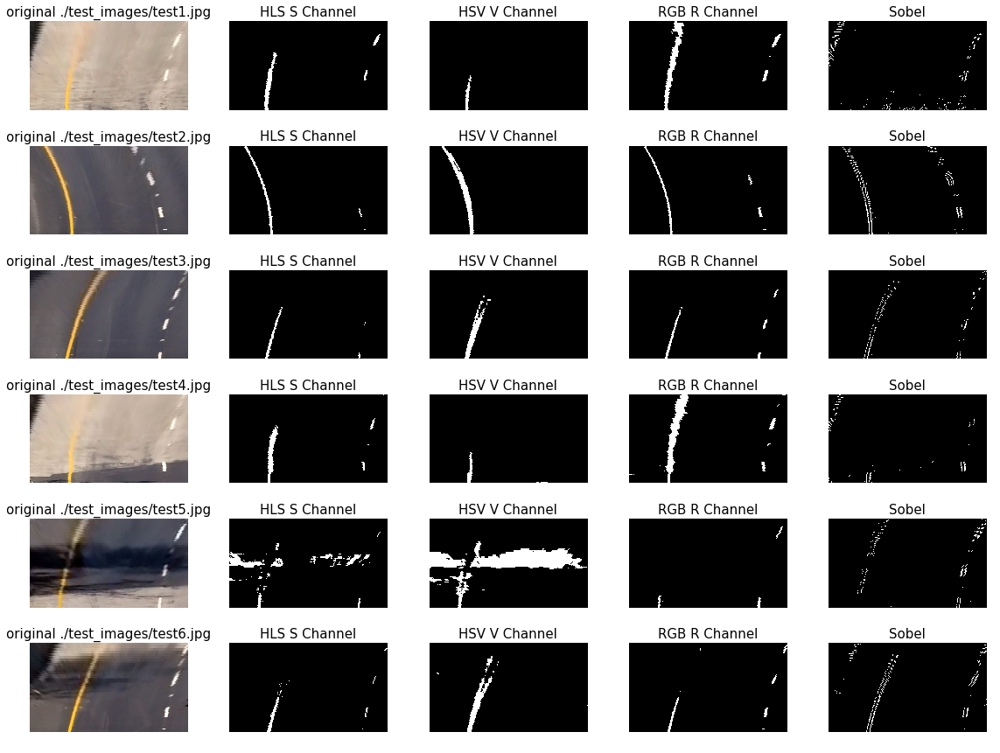

In [142]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
#     axs[i].axis('off')
#     axs[i].imshow(L, cmap='gray')
#     axs[i].set_title('HLS L Channel', fontsize=15)
#     i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1

## Image Pipeline

In [155]:

def binaryPipe(img):
    
    # Copy the image
    img = np.copy(img)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Get the Red and saturation images
    red = rgb_rthresh(warped, thresh=(225, 255))
    sat = hls_sthresh(warped, thresh=(175, 255))
    
    # Run the sobel magnitude calculation
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    # combine these layers
    combined_binary = np.zeros_like(sobel)
    combined_binary[(sat == 1) | (red == 1) | sobel == 1] = 1
    
    return combined_binary

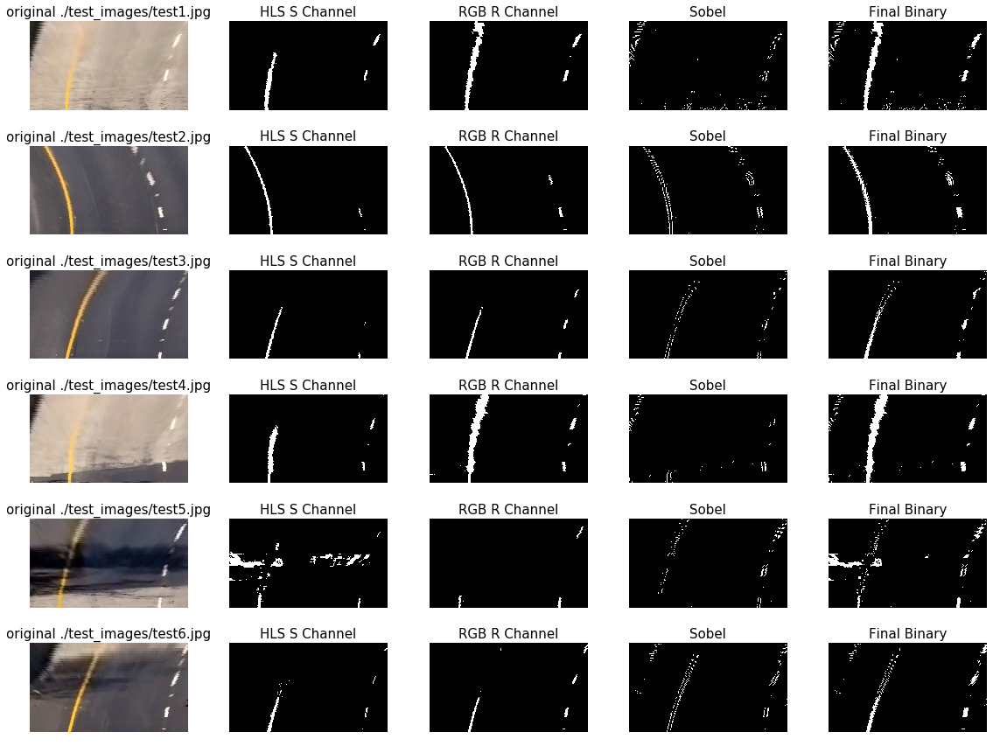

In [176]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)
    
    # Run this through our binary pipeline
    binary_img = binaryPipe(img)
    
    ### The below is just so we can see the makeup of the binary pipeline
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(150, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(binary_img, cmap='gray')
    axs[i].set_title('Final Binary', fontsize=15)
    i += 1

### Functions for the window functions

In [ ]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(warped[int(3*warped.shape[0]/4):,int(warped.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(warped.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(warped.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,warped.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,warped.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

In [ ]:
def calc_radius(left_fit, right_fit, y_eval):
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)

    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    # Now our radius of curvature is in meters
    print(left_curverad, 'm', right_curverad, 'm')

    return left_curerad, right_curverad
    

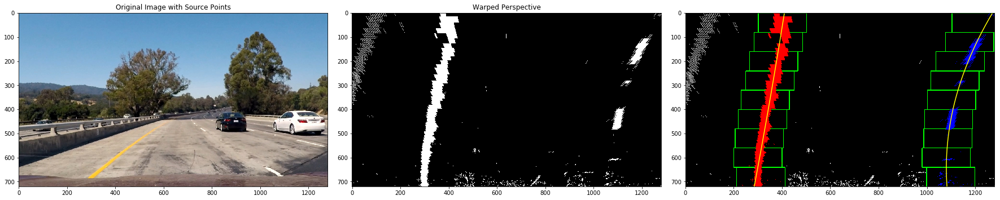

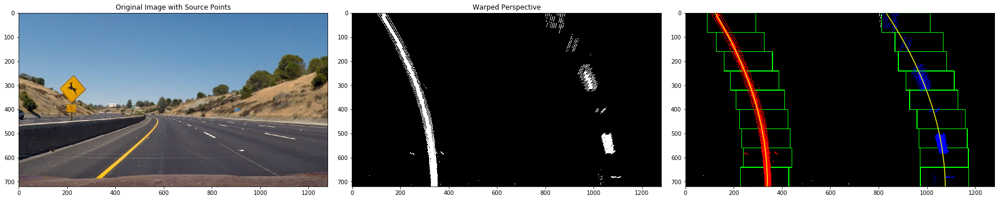

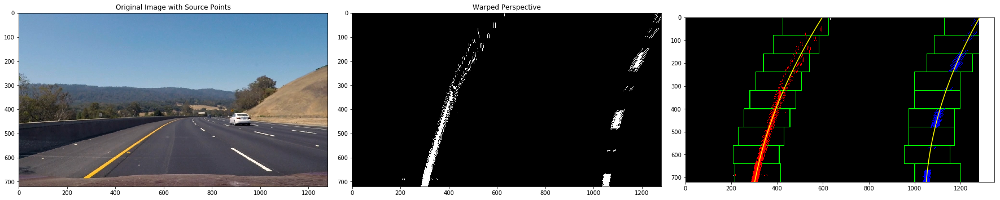

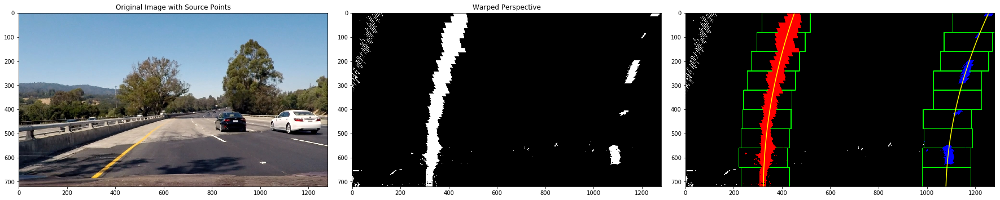

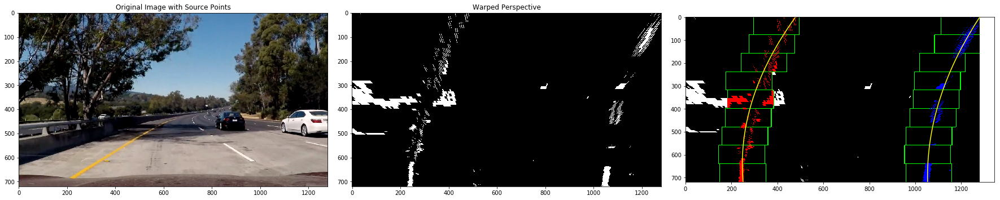

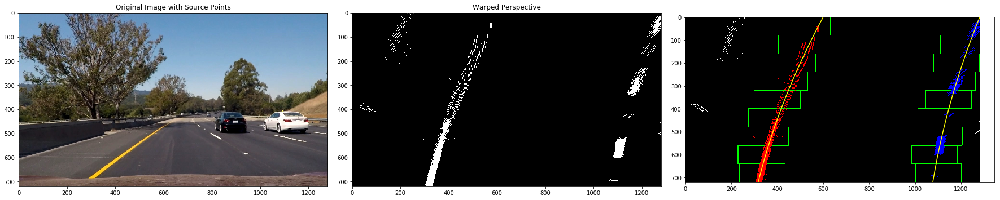

In [177]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')


### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)


    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]


#     # window settings
#     window_width = 50 
#     window_height = 80 # Break image into 9 vertical layers since image height is 720
#     margin = 100 # How much to slide left and right for searching
    
#     window_centroids = find_window_centroids(warped_binary, window_width, window_height, margin)
    
#     # If we found any window centers
#     if len(window_centroids) > 0:

#         # Points used to draw all the left and right windows
#         l_points = np.zeros_like(warped)
#         r_points = np.zeros_like(warped)

#         # Go through each level and draw the windows 	
#         for level in range(0,len(window_centroids)):
#             # Window_mask is a function to draw window areas
#             l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
#             r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
#             # Add graphic points from window mask here to total pixels found 
#             l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
#             r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

#         # Draw the results
#         template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
#         zero_channel = np.zeros_like(template) # create a zero color channel
#         template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
#         warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
#         output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

#     # If no window centers found, just display orginal road image
#     else:
#         output = np.array(cv2.merge((warped,warped,warped)),np.uint8)


    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image with Source Points')
    
    ax2.imshow(binary_warped, cmap='gray')
    ax2.set_title('Warped Perspective')
    
    ax3.imshow(out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



In [ ]:
plt.close('all')